In [1]:
%matplotlib inline

In [93]:
import numpy as np
import matplotlib.pyplot as plt
import scipy

from matplotlib import animation, rc
from IPython.display import HTML
rc('animation', html='jshtml')
import seaborn as sns

#Define plotting style:
sns.set() #Set style
sns.set_style('ticks',{'font.family':'serif', 'font.serif':'Times New Roman'})
sns.set_style('ticks',{'font.family':'serif', 'font.serif':'Times New Roman'})
sns.set_context('paper', font_scale=1.8,  rc={"lines.linewidth": 3})
sns.set_palette(sns.color_palette("deep"))

### Modelo Classico (oscilador harmônico + força de dissipação)

In [94]:
def E(t,E0,w):
    return E0*np.cos(w*t)

def RHS(xV,t,m,w0,n,e,w,E0):
    return (xV[1],-w0**2*xV[0] - (n/m)*xV[1] -e*E(t,E0,w))
    

### Solução sem dissipação

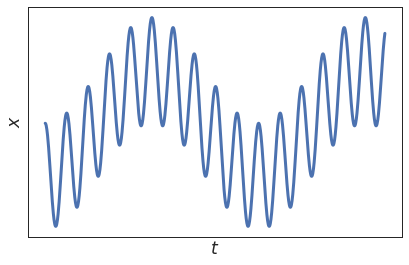

In [99]:
#Constantes em unidades arbitrárias:
m = 1.0 #massa
w0 = 0.1 #frequência do oscilador
k = m*w0**2 #constante elástica
n = 0.0 #constante dissipativa
e = 1 #carga elétrica
E0 = 1e-3 # amplitude do campo elétrico

w = w0/10 # frequência do campo elétrico
#Condicoes iniciais:
x0 = [0,0]
t = np.linspace(0,1000,1000)
xV_sol = scipy.integrate.odeint(RHS,x0,t,args=(m,w0,n,e,w,E0))
x_sol = xV_sol[:,0]

#Função analítica para o limite onde x(t=0) = xmax
@np.vectorize
def x_ana(t,e,E0,m,w0,w):
    xmax = (-e*E0/m)*1/(w0**2-w**2)
    return xmax*np.cos(w*t)
    

fig = plt.figure(figsize=(6,4))
plt.plot(t,x_sol)
# plt.hlines(y=max(x_sol),xmin=min(t),xmax=max(t),linestyle='--')
# plt.plot(t,x_ana(t,e=e,E0=E0,m=m,w0=w0,w=w),'--')
plt.xlabel(r'$t$')
plt.ylabel(r'$x$')
plt.xticks([])
plt.yticks([])
plt.tight_layout()
plt.savefig('fotoeletricoClassico1.pdf')
plt.show()

In [37]:
#Constantes em unidades arbitrárias:
m = 1.0 #massa
w0 = 0.1 #frequência do oscilador
k = m*w0**2 #constante elástica
n = 0.02 #constante dissipativa
e = 1 #carga elétrica
E0 = 1e-3 # amplitude do campo elétrico

In [38]:
w = w0/5 # frequência do campo elétrico
#Condicoes iniciais:
x0 = [0,0]
t = np.linspace(0,500,1000)
xV_solA = scipy.integrate.odeint(RHS,x0,t,args=(m,w0,n,e,w,E0))
x_solA = xV_solA[:,0]
labelA = r'$\omega/\omega_0 = %1.1f$' %(w/w0)

In [48]:
#Constantes em unidades arbitrárias:
w = w0 # frequência do campo elétrico
#Condicoes iniciais:
x0 = [0,0]
t = np.linspace(0,500,1000)
xV_solB = scipy.integrate.odeint(RHS,x0,t,args=(m,w0,n,e,w,E0))
x_solB = xV_solB[:,0]
labelB = r'$\omega/\omega_0 = %1.1f$' %(w/w0)

In [49]:
#Constantes em unidades arbitrárias:
w = 5*w0 # frequência do campo elétrico
#Condicoes iniciais:
x0 = [0,0]
t = np.linspace(0,500,1000)
xV_solC = scipy.integrate.odeint(RHS,x0,t,args=(m,w0,n,e,w,E0))
x_solC = xV_solC[:,0]
labelC = r'$\omega/\omega_0 = %1.1f$' %(w/w0)

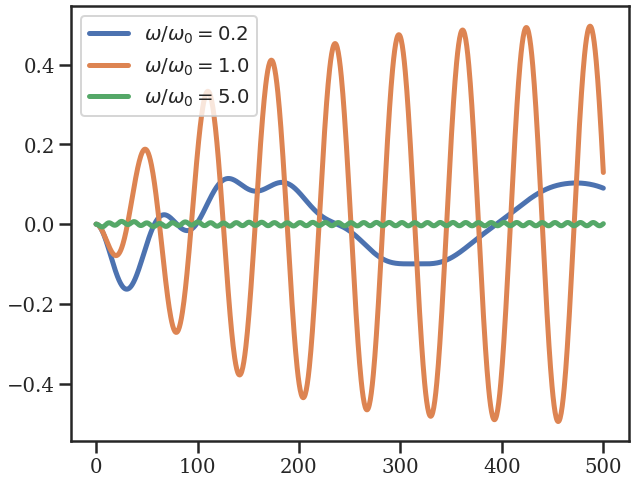

In [50]:
fig = plt.figure(figsize=(10,8))
plt.plot(t,x_solA,label=labelA)
plt.plot(t,x_solB,label=labelB)
plt.plot(t,x_solC,label=labelC)
plt.legend()
plt.show()

### Animacao

In [55]:
tmin, tmax = 0,1000 #Tempo inicial e final
dt = 2.0 #Intervalo de tempo
npts = 100 #Numero de pontos
tpts = np.linspace(tmin,tmax,npts)

#Solução:
w = w0 # frequência do campo elétrico
#Condicoes iniciais:
x0 = [0,0]
xV_sol = scipy.integrate.odeint(RHS,x0,tpts,args=(m,w0,n,e,w,E0))
x_sol = xV_sol[:,0]
xmin,xmax = min(x_sol),max(x_sol)
xF = scipy.interpolate.interp1d(tpts,x_sol)

In [56]:
fig = plt.figure(figsize=(22,7))
ax1 = plt.subplot(121)
pt, = ax1.plot([xF(tmin),0.],'o',markersize=25)
line, = ax1.plot([0.,xF(tmin)],[0.,0.],'--')
textA = ax1.text((xmax+xmin)/2, 0.09, r'$x=%2.3f$ m' %xF(tmin),fontsize=20)
xlabel = ax1.set_xlabel('x')
ax1.set_xlim(xmin,xmax)
ax1.set_ylim(-0.1,0.1)

ax2 = plt.subplot(122)
Kl, = ax2.plot(tpts,xF(tpts),'--',linewidth=4.0)
xlabel = ax2.set_xlabel('t (s)')
ax2.legend(['x'],loc='upper right',framealpha=1.0,fontsize=25.0)


def init():
    tpts = [tmin]
    pt.set_data([xF(tmin)],[0.])
    line.set_data([0.,xF(tmin)],[0.,0.])
    line._linewidth = 3.0
    Kl.set_data(tpts,xF(tpts))
    textA.set_text(r'$x=%2.3f$ m' %xF(tmin))
#     text.set_text(r'$K=%2.3f$ J' %KF(tmin))
    return (pt,line,Kl,textA)

def animate(i):
    
    tA = tmin+i*dt
    tpts = np.linspace(tmin,tA,100)
    xpt = [xF(tA)]
    ypt = [0.]
    pt.set_data(xpt,ypt)
    line.set_data([0.,xF(tA)],[0.,0.])
    line._linewidth = 4.0/(0.1+abs(xF(tA))/2.)
    Kl.set_data(tpts,xF(tpts))
    textA.set_text(r'$x=%2.3f$ m' %xF(tA))
#     text.set_text(r'$K=%2.3f$ J' %KF(tA))
    return (pt,line,Kl,textA)


anim = animation.FuncAnimation(fig, animate, init_func=init,
                               frames=int((tmax-tmin)/dt), interval=50, 
                               blit=True)
plt.close()
anim

Animation size has reached 21048870 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
